# Using Transfer Learning and Tensorflow 2.0 to predict different dog breeds

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

# Check for GPU
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.8.0
Hub version: 0.12.0
GPU available (YESS!!!!)


In [ ]:
# !unzip "drive/MyDrive/dog-breed-identification/dog-breed-identification.zip" -d "drive/MyDrive/dog-breed-identification/"

In [ ]:
# Check out labels for our data
import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/dog-breed-identification/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


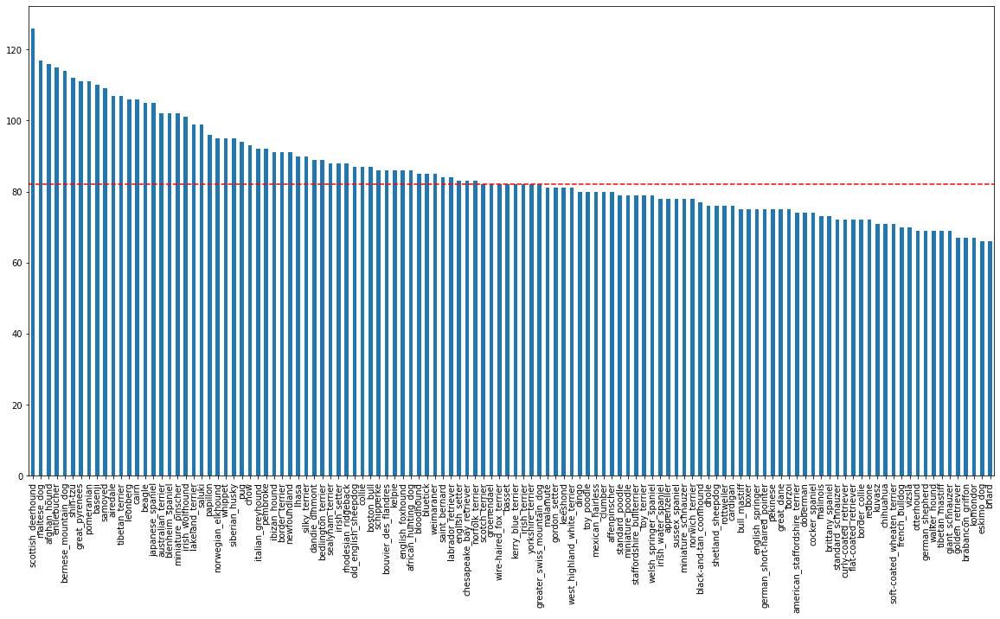

In [ ]:
# How many images are there for each breed
plt = labels_csv["breed"].value_counts().plot.bar(figsize=(20,10));
plt.axhline(labels_csv["breed"].value_counts().median(), linestyle="--", color="red");

In [ ]:
labels_csv["breed"].value_counts().median()

82.0

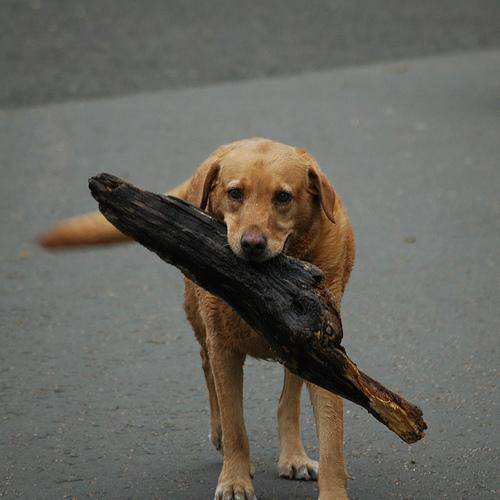

In [ ]:
from IPython.display import display, Image
Image("drive/MyDrive/dog-breed-identification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg")

## Getting images and their labels
* A list of filepaths to training images
* An array of all labels
* An array of unique labels

In [ ]:
# Create pathnames from image IDs
filenames = ["drive/MyDrive/dog-breed-identification/train/" + fname + ".jpg" for fname in labels_csv.id]

filenames[:10]

['drive/MyDrive/dog-breed-identification/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/dog-breed-identification/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/dog-breed-identification/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/dog-breed-identification/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/dog-breed-identification/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/dog-breed-identification/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/dog-breed-identification/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/dog-breed-identification/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/dog-breed-identification/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/dog-breed-identification/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

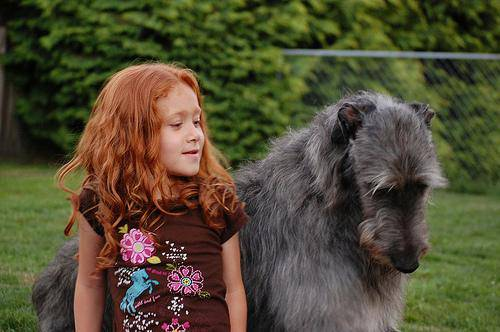

In [ ]:
Image("drive/MyDrive/dog-breed-identification/train/0042188c895a2f14ef64a918ed9c7b64.jpg")

In [ ]:
# Check whether number of filenames match the number of images in the training set
import os
if len(os.listdir("drive/MyDrive/dog-breed-identification/train/"))== len(filenames):
  print("Filenames match actual amount of files")
  print("Number of files are", len(filenames))
else:
  print("Check target directory")

Filenames match actual amount of files
Number of files are 10222


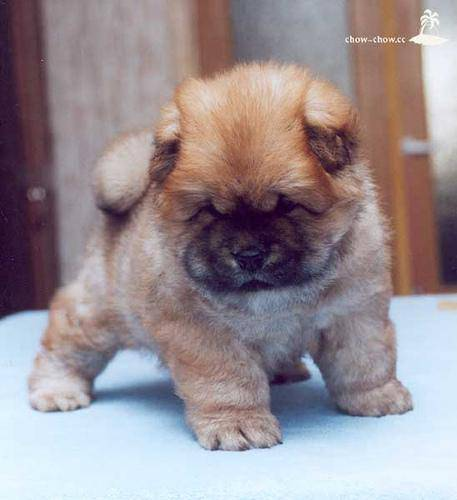

In [ ]:
Image(filenames[6574])

In [ ]:
import numpy as np
labels =labels_csv["breed"].to_numpy()
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

In [ ]:
if len(labels)==len(filenames):
  print("Number of labels is same as number of file names ")
else:
  print("Check data directories")

Number of labels is same as number of file names 


In [ ]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
# Turn one label into boolean values
print(labels[0])
labels[0] == unique_breeds 

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn every label into boolean array
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[3]

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turning boolean array into integers
print(labels[0])
print(np.where(unique_breeds == labels[0])[0][0]) # index where label occurs
print(boolean_labels[0].argmax())
print(boolean_labels[0].astype(int))

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


## Creating validation set

In [ ]:
# Setup variables
X = filenames
y = boolean_labels

In [ ]:
# Set number of images to use for experimenting
NUM_IMAGES = 4000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

4000

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size = 0.2,
                                                  random_state= 42) 
len(X_train), len(y_train), len(X_val), len(y_val)

(3200, 3200, 800, 800)

In [ ]:
# Check out training data
X_train[:5], y_train[3:5]

(['drive/MyDrive/dog-breed-identification/train/6338aedbf9de0ccbc208bdc99f8f2431.jpg',
  'drive/MyDrive/dog-breed-identification/train/0a3f1898556115d6d0931294876cd1d9.jpg',
  'drive/MyDrive/dog-breed-identification/train/49f0ef56406121db3ec89e2efa83aa03.jpg',
  'drive/MyDrive/dog-breed-identification/train/1e22e0538fb7aa3e9ffa72fc8244c182.jpg',
  'drive/MyDrive/dog-breed-identification/train/0c286c574ef09562c123dafe5ce6ac23.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False,  True, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, Fa

## Preprocessing images(Turning images into tensors)
**Steps**
1. Takes an image filename as input.
2. Uses TensorFlow to read the file and save it to a variable, image.
3. Turn our image (a jpeg file) into Tensors.
4. Resize the image to be of shape (224, 224)
5. Return the modified image.

In [ ]:
# Convert image into NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[42]) #Read in an image
image.shape

(257, 350, 3)

In [ ]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

In [ ]:
# Writing custom function to change images to tensors
IMG_SIZE = 224

def process_image(image_path):
  # Read an image file
  image = tf.io.read_file(image_path)
  # Turn jpeg image into tensors (rgb)
  image = tf.io.decode_jpeg(image,channels=3)
  # Convert the colour channels from 0-255 to 0-1
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to desired size(244,244)
  image = tf.image.resize(image, size =[IMG_SIZE, IMG_SIZE])
  return image

## Create data batches

In [ ]:
# Create a simple function to return a tuple(image, label)
def get_image_label(image_path, label):
  image = process_image(image_path)
  return image,label

In [ ]:
# Function to make data batches

BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size = BATCH_SIZE, valid_data=False, test_data = False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  # Test set won't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices(tf.constant(x)) # Only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  # Validation set need not be shuffled
   # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  
  else:
    # Shuffle training dataset
    print("Creating training data batches")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                               tf.constant(y)))
    data = data.shuffle(buffer_size=len(x))
    data = data.map(get_image_label) # Another way to create tuples (this also turns the image path into a preprocessed image)

    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data = True)

Creating training data batches
Creating validation data batches...


In [ ]:
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing data batches

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn gird lines off
    plt.axis(False)

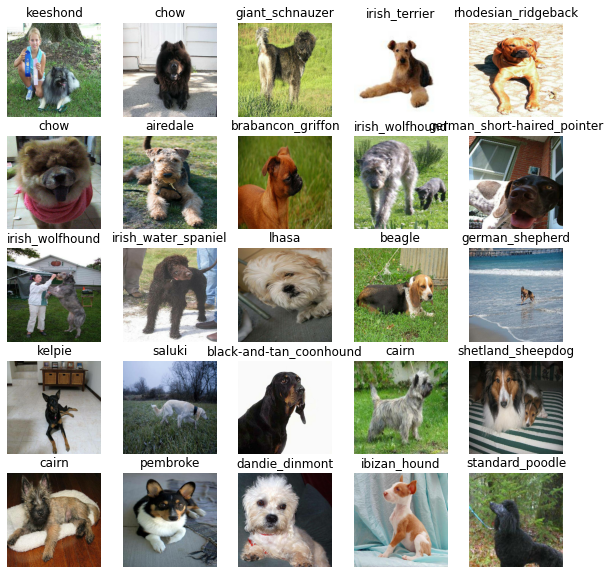

In [ ]:
# Visualize training images from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

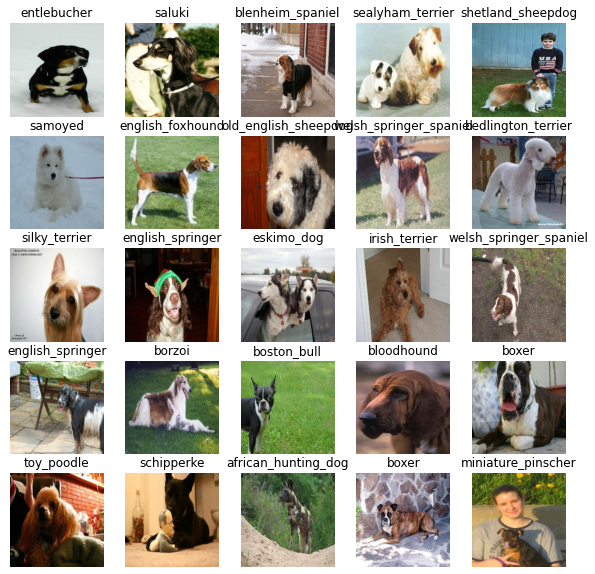

In [ ]:
# Visualize validation images from the validation data batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Creating and training a model


### Building a model
Before we build a model, there are a few things we need to define:

* The input shape (images, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use.

In [ ]:
# Setup the input shape of the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # Batch, Height, Width, Colour Channels

# Setup output shape for the model
OUTPUT_SHAPE = len(unique_breeds)

# Setup mdoel url from Tensorflow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

Creating a function which
* Takes the input shape, output shape and the model we've chosen's URL as parameters.
* Defines the layers in a Keras model in a sequential fashion (do this first, then this, then that).
* Compiles the model (says how it should be evaluated and improved).
* Builds the model (tells it what kind of input shape it'll be getting).
Returns the model.

In [ ]:
# Create a function which builds a keras model
def create_model(input_shape = INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with", MODEL_URL)

  # Setup the model layer
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1, Input layer 
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                         activation = "softmax") # Layer 2, output layer
  ])

  # Compile the model
  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE) # Telling model the kinds of inputs

  return model

In [ ]:
# Create a model and check it's details
model = create_model()
model.summary()

Building model with https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating Callbacks

In [ ]:
%load_ext tensorboard


In [ ]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/MyDrive/dog-breed-identification/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [ ]:
# Early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor= "val_accuracy",
                                                  patience=3) #Stops after 3 rounds of no improvements

## Training a model(on a subset of data)

In [ ]:
# Check again if GPU is available 
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YESS!!!!)


In [ ]:
# Defining epochs
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

Create a simple function which trains a model. The function will:

* Create a model using `create_model()`.
* Setup a TensorBoard callback using `create_tensorboard_callback`() (we do this here so it creates a log directory of the current date and time).
* Call the `fit()` function on our model passing it the training data, validatation data, number of epochs to train for and the callbacks we'd like to use.
* Return the fitted model.

In [ ]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard, early_stopping])
  
  return model

In [ ]:
# Fit model to the data
model = train_model()

Building model with https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
100/100 [==============================] - 139s 1s/step - loss: 2.5042 - accuracy: 0.4547 - val_loss: 1.0444 - val_accuracy: 0.7063
Epoch 2/100
100/100 [==============================] - 13s 125ms/step - loss: 0.5238 - accuracy: 0.8737 - val_loss: 0.8080 - val_accuracy: 0.7763
Epoch 3/100
100/100 [==============================] - 13s 129ms/step - loss: 0.2506 - accuracy: 0.9550 - val_loss: 0.7668 - val_accuracy: 0.7763
Epoch 4/100
100/100 [==============================] - 16s 158ms/step - loss: 0.1428 - accuracy: 0.9850 - val_loss: 0.7368 - val_accuracy: 0.7775
Epoch 5/100
100/100 [==============================] - 13s 133ms/step - loss: 0.0955 - accuracy: 0.9928 - val_loss: 0.7325 - val_accuracy: 0.7875
Epoch 6/100
100/100 [==============================] - 13s 133ms/step - loss: 0.0667 - accuracy: 0.9975 - val_loss: 0.7196 - val_accuracy: 0.7887
Epoch 7/100
100/100 [=============

In [ ]:
%tensorboard --logdir drive/My\ Drive/dog-breed-identification/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using trained model


In [ ]:
# Make predictions on validation data
predictions = model.predict(val_data, verbose=1)
predictions

25/25 [==============================] - 6s 111ms/step


array([[2.1008459e-06, 5.1620045e-06, 4.6772720e-06, ..., 5.9009599e-06,
        1.5827716e-05, 2.8123502e-06],
       [1.9817790e-05, 1.1396323e-03, 2.6690257e-06, ..., 3.8778227e-05,
        7.8298808e-06, 1.3747638e-05],
       [4.7324334e-06, 3.8619855e-05, 4.0544400e-08, ..., 8.2296864e-08,
        1.2069840e-04, 4.9227683e-06],
       ...,
       [2.0839225e-05, 2.0414129e-05, 1.1338338e-05, ..., 5.4646358e-07,
        2.5100601e-04, 1.2730032e-05],
       [4.1924550e-06, 2.4983085e-06, 6.3070133e-06, ..., 9.8855048e-01,
        1.6954243e-04, 3.8109900e-07],
       [1.7911059e-07, 7.0430644e-07, 1.3686693e-07, ..., 3.1751014e-08,
        1.8963068e-06, 1.2619641e-04]], dtype=float32)

In [ ]:
# Check shape of predictions
predictions.shape

(800, 120)

In [ ]:
# Converting an array of probabilites to an actual label
# First prediction
print(predictions[0])
print(f"Max Value(probability of predictions):, {np.max(predictions[0])}") # Max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # Sum will be close to one because of softmax function
print(f"Max Index:{np.argmax(predictions[0])}") # Index of where the max value in the predictions will occur
print(f"Predicted Label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label                                 

[2.10084590e-06 5.16200453e-06 4.67727205e-06 4.97406327e-05
 8.63523572e-04 2.41569104e-03 1.61385901e-06 4.34123067e-04
 2.68009135e-05 2.58484524e-05 3.73988041e-06 5.02387302e-05
 1.81346899e-04 7.92386072e-06 2.18107016e-06 2.05518245e-06
 1.56293754e-05 6.26588517e-05 9.14924328e-07 3.77731812e-05
 5.09389906e-07 1.29602349e-05 1.70819640e-05 2.94998335e-06
 4.78920447e-06 3.03624165e-06 8.16136492e-07 2.00498253e-05
 1.10934138e-06 3.76929506e-06 3.88109083e-06 4.23167478e-07
 1.82793173e-07 1.16776285e-07 5.79415882e-06 1.83576446e-06
 2.08441156e-06 2.17863385e-06 1.56869264e-05 1.15439754e-04
 3.13031222e-07 4.65567064e-06 9.76376057e-01 1.36771614e-05
 8.37868083e-06 1.22426900e-06 3.57188765e-06 6.11759242e-06
 1.44891260e-06 4.53304347e-06 1.10085584e-05 1.66832774e-06
 4.13746784e-06 1.57314744e-02 2.85387109e-08 4.98461714e-06
 5.10961968e-07 3.91658114e-06 5.10430596e-07 3.27590465e-06
 8.84119288e-07 6.05484320e-06 1.07309313e-06 4.92295439e-05
 2.65206086e-06 5.553137

In [ ]:
# Turn prediction probabilities(confidence levels) into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of predictions into respective label
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'entlebucher'

Since our validation data (val_data) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using `unbatch()`) and then turn it into an iterator using `as_numpy_iterator()`.

In [ ]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.7922948 , 0.8275889 , 0.8158242 ],
         [0.8123885 , 0.8476826 , 0.8359179 ],
         [0.79904485, 0.83433896, 0.82257426],
         ...,
         [0.8117648 , 0.8470589 , 0.8352942 ],
         [0.8117648 , 0.8470589 , 0.8352942 ],
         [0.8117648 , 0.8470589 , 0.8352942 ]],
 
        [[0.80639017, 0.8416843 , 0.8299196 ],
         [0.8028001 , 0.83809423, 0.8263295 ],
         [0.803159  , 0.8384531 , 0.8266884 ],
         ...,
         [0.81568635, 0.85098046, 0.83921576],
         [0.81568635, 0.85098046, 0.83921576],
         [0.81568635, 0.85098046, 0.83921576]],
 
        [[0.80020356, 0.8354977 , 0.823733  ],
         [0.8046996 , 0.8399937 , 0.828229  ],
         [0.80884004, 0.84413415, 0.83236945],
         ...,
         [0.81818986, 0.853484  , 0.84171927],
         [0.81818986, 0.853484  , 0.84171927],
         [0.81818986, 0.853484  , 0.84171927]],
 
        ...,
 
        [[0.7951923 , 0.8108786 , 0.806957  ],
         [0.8004999 , 0.8161862 , 0.81226

## Function to do the following:
* Take an array of prediction probabilities, an array of truth labels, an array of images and an integer.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label and target image on a single plot.

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image and remove tics
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the title depending on the correctness of the predictions
 
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

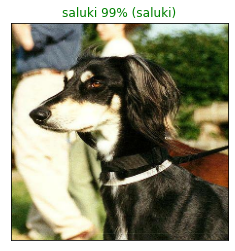

In [ ]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

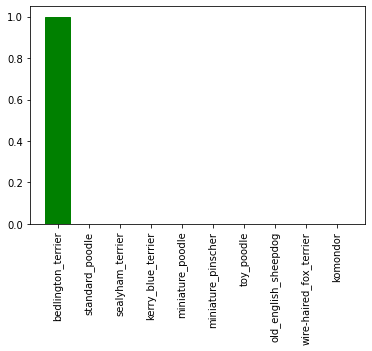

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

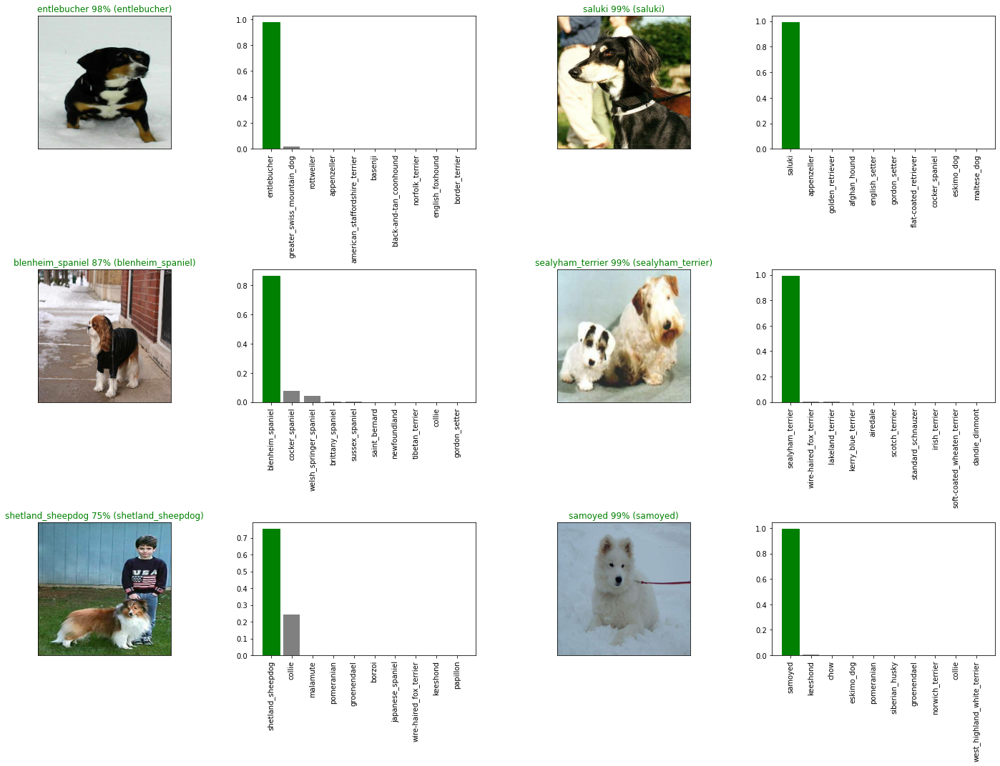

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

In [ ]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/dog-breed-identification/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 4000 images
save_model(model, suffix="4000-images-Adam")

Saving model to: drive/MyDrive/dog-breed-identification/models/20220508-15151652022954-4000-images-Adam.h5...


'drive/MyDrive/dog-breed-identification/models/20220508-15151652022954-4000-images-Adam.h5'

In [ ]:
# Load our model trained on 1000 images
model_4000_images = load_model('drive/MyDrive/dog-breed-identification/models/20220508-11331652009602-4000-images-Adam.h5')

Loading saved model from: drive/MyDrive/dog-breed-identification/models/20220508-11331652009602-4000-images-Adam.h5


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

25/25 [==============================] - 3s 101ms/step - loss: 0.7168 - accuracy: 0.7925


[0.7168372273445129, 0.7925000190734863]

In [ ]:
# Evaluate the loaded model
model_4000_images.evaluate(val_data)

25/25 [==============================] - 3s 97ms/step - loss: 0.7435 - accuracy: 0.7812


[0.7435446381568909, 0.78125]

## Training a model (on the full data)

In [ ]:
len(X), len(y)

(10222, 10222)

In [ ]:
# Turn full training data into a data batch
full_data = create_data_batches(X,y)

Creating training data batches


In [ ]:
# Instantiate a new model for training on new dataset
full_model= create_model()

Building model with https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
# Create full model callbacks
# Tensorboard callback
full_model_tensorboard = create_tensorboard_callback()  

# Early stopping callback
# No validation set on training data so cannot monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [ ]:
%tensorboard --logdir drive/My\ Drive/dog-breed-identification/logs

Reusing TensorBoard on port 6006 (pid 6563), started 0:48:04 ago. (Use '!kill 6563' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 56s 152ms/step - loss: 1.3526 - accuracy: 0.6681
Epoch 2/100
320/320 [==============================] - 61s 190ms/step - loss: 0.4001 - accuracy: 0.8814
Epoch 3/100
320/320 [==============================] - 49s 153ms/step - loss: 0.2353 - accuracy: 0.9374
Epoch 4/100
320/320 [==============================] - 52s 162ms/step - loss: 0.1532 - accuracy: 0.9651
Epoch 5/100
320/320 [==============================] - 51s 161ms/step - loss: 0.1063 - accuracy: 0.9784
Epoch 6/100
320/320 [==============================] - 53s 164ms/step - loss: 0.0784 - accuracy: 0.9864
Epoch 7/100
320/320 [==============================] - 52s 164ms/step - loss: 0.0576 - accuracy: 0.9921
Epoch 8/100
320/320 [==============================] - 52s 162ms/step - loss: 0.0473 - accuracy: 0.9931
Epoch 9/100
320/320 [==============================] - 53s 165ms/step - loss: 0.0366 - accuracy: 0.9962
Epoch 10/100
320/320 [==============================] - 52s 163m

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/MyDrive/dog-breed-identification/models/20220508-12571652014655-all-images-Adam.h5...


'drive/MyDrive/dog-breed-identification/models/20220508-12571652014655-all-images-Adam.h5'

In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/dog-breed-identification/models/20220508-12571652014655-all-images-Adam.h5')

Loading saved model from: drive/MyDrive/dog-breed-identification/models/20220508-12571652014655-all-images-Adam.h5


## Making predictions on test dataset

In [ ]:
# Load test image filenames
test_path = "drive/MyDrive/dog-breed-identification/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/MyDrive/dog-breed-identification/test/de4223b8c5ca7b80d34d1cd2b5e62351.jpg',
 'drive/MyDrive/dog-breed-identification/test/deec27ba9446dfe31c0b32586f175d6a.jpg',
 'drive/MyDrive/dog-breed-identification/test/e2c7aeef019a6577f3988a84be2b5769.jpg',
 'drive/MyDrive/dog-breed-identification/test/e1b0cbcf3235fe9a7b35c1652081ff8d.jpg',
 'drive/MyDrive/dog-breed-identification/test/e330d9cfe81e42338ddbf8a121930e83.jpg',
 'drive/MyDrive/dog-breed-identification/test/e34bd9a8afc5280b5f2f7489f48c8e7d.jpg',
 'drive/MyDrive/dog-breed-identification/test/dcab2d03a686ab3f31d1bc3e5700f6d1.jpg',
 'drive/MyDrive/dog-breed-identification/test/e648a16d81b6441658b77bca0f1be4ee.jpg',
 'drive/MyDrive/dog-breed-identification/test/e2888231cedd08540816e629c0733922.jpg',
 'drive/MyDrive/dog-breed-identification/test/e713f150e4f9fc828f8a28705755f199.jpg']

In [ ]:
len(test_filenames)

10357

In [ ]:
# Create test databatch
test_data = create_data_batches(test_filenames, test_data = True)

Creating test data batches...


In [ ]:
# Make predictions on test model using loaded full model
test_predictions = loaded_full_model.predict(test_data, verbose=1)

324/324 [==============================] - 1170s 4s/step


In [ ]:
# Check out the test predictions
test_predictions[:10]

array([[4.2757388e-11, 1.5797018e-09, 2.3069019e-06, ..., 1.1734026e-04,
        3.5906240e-05, 1.4098949e-11],
       [7.4587862e-12, 6.5648592e-10, 2.9414264e-12, ..., 1.0431972e-09,
        2.9460473e-12, 2.4290119e-12],
       [6.2289653e-12, 4.5724363e-16, 1.7482633e-11, ..., 5.7142568e-11,
        1.1539049e-13, 3.3261935e-07],
       ...,
       [1.0851709e-11, 7.1699161e-12, 7.1516148e-08, ..., 1.0491591e-07,
        1.4098713e-07, 7.8982659e-10],
       [2.0967340e-08, 1.5559205e-07, 3.8125560e-09, ..., 3.8855987e-07,
        3.4347581e-04, 3.6397965e-10],
       [2.0784138e-12, 6.1075184e-15, 4.8109024e-11, ..., 1.1667138e-09,
        8.2802081e-12, 1.7067072e-09]], dtype=float32)

In [ ]:
# Get custom image prediction labels
test_pred_labels = [get_pred_label(test_predictions[i]) for i in range(len((test_predictions)))]
test_pred_labels[:15]

['dingo',
 'bernese_mountain_dog',
 'toy_terrier',
 'malamute',
 'staffordshire_bullterrier',
 'saluki',
 'golden_retriever',
 'dingo',
 'basset',
 'toy_terrier',
 'tibetan_terrier',
 'toy_poodle',
 'boston_bull',
 'vizsla',
 'keeshond']

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
test_images = []
# Loop through unbatched data
for image in test_data.unbatch().as_numpy_iterator():
  test_images.append(image)

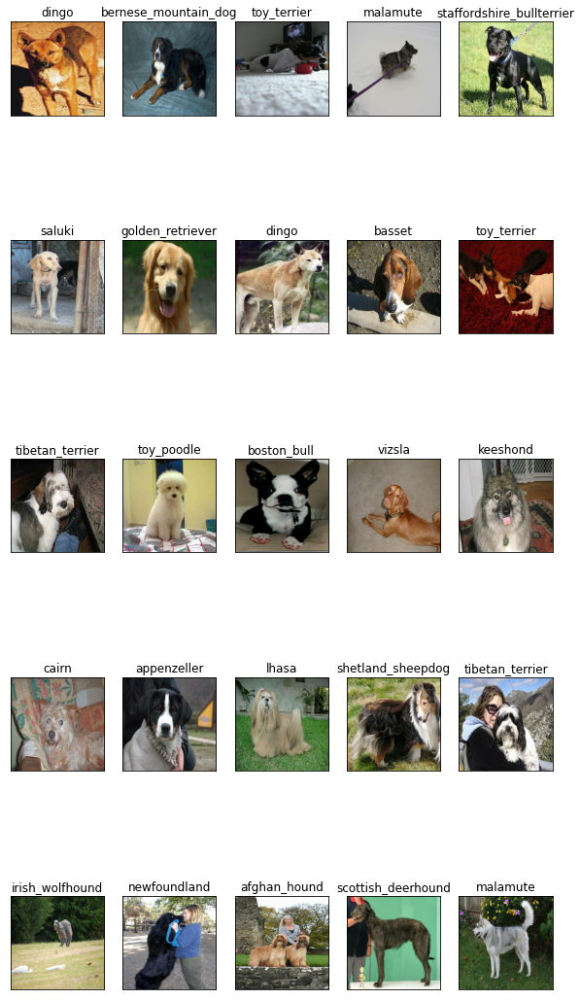

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 20))
for i, image in enumerate(test_images[:25]):
  plt.subplot(5, 5, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(test_pred_labels[i])
  plt.imshow(image)

## Making predictions on custom images

In [ ]:
# Get custom image filepaths
custom_path = "drive/MyDrive/dog-breed-identification/dogs/"
custom_image_path = [custom_path + fname for fname in os.listdir(custom_path)]


In [ ]:
# Turn custom images into batches
custom_data = create_data_batches(custom_image_path, test_data= True)

Creating test data batches...


In [ ]:
# Make predictions on custom data
custom_preds = loaded_full_model.predict(custom_data)

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['beagle', 'beagle', 'miniature_poodle', 'tibetan_terrier', 'pembroke']

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

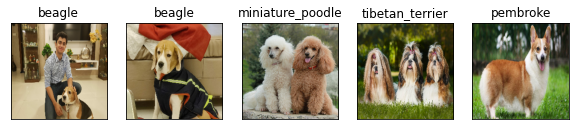

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 20))
for i, image in enumerate(custom_images):
  plt.subplot(1, 5, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)

*****